#Loading Data

In [ ]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("uciml/breast-cancer-wisconsin-data")

print("Path to dataset files:", path)

100%|██████████| 48.6k/48.6k [00:00<00:00, 42.2MB/s]

Extracting files...
Path to dataset files: /root/.cache/kagglehub/datasets/uciml/breast-cancer-wisconsin-data/versions/2


In [ ]:
ls /root/.cache/kagglehub/datasets/uciml/breast-cancer-wisconsin-data/versions/2

data.csv


In [ ]:
import pandas as pd
df= pd.read_csv("/root/.cache/kagglehub/datasets/uciml/breast-cancer-wisconsin-data/versions/2/data.csv")

In [ ]:
df.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

In [ ]:
df=df.drop(columns=["id"],axis=1)
df=df.drop(columns=["Unnamed: 32"],axis=1)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 31 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   diagnosis                569 non-null    object 
 1   radius_mean              569 non-null    float64
 2   texture_mean             569 non-null    float64
 3   perimeter_mean           569 non-null    float64
 4   area_mean                569 non-null    float64
 5   smoothness_mean          569 non-null    float64
 6   compactness_mean         569 non-null    float64
 7   concavity_mean           569 non-null    float64
 8   concave points_mean      569 non-null    float64
 9   symmetry_mean            569 non-null    float64
 10  fractal_dimension_mean   569 non-null    float64
 11  radius_se                569 non-null    float64
 12  texture_se               569 non-null    float64
 13  perimeter_se             569 non-null    float64
 14  area_se                  5

#EDA

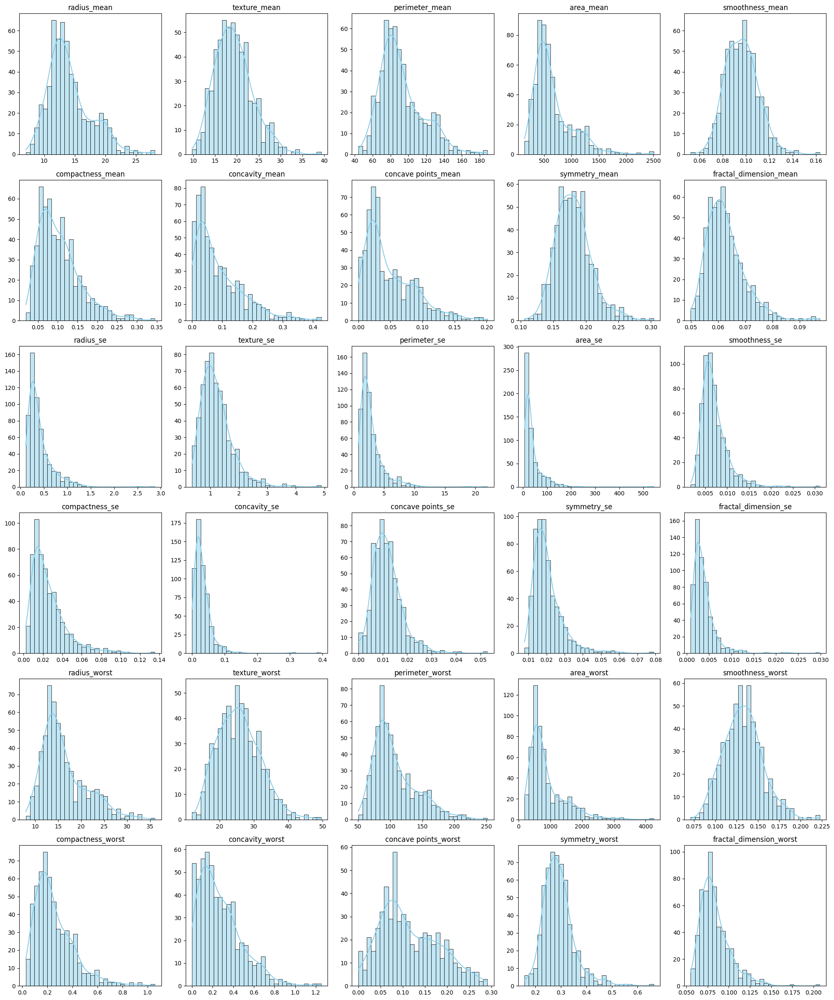

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Assuming 'data' is your DataFrame and already loaded
numerical_columns = df.select_dtypes(include=['number']).columns

# Plot settings
num_features = len(numerical_columns)
cols = 5
rows = (num_features + cols - 1) // cols  # Calculate number of rows needed

plt.figure(figsize=(20, 4 * rows))  # Adjust the overall size

for i, column in enumerate(numerical_columns):
    plt.subplot(rows, cols, i + 1)
    sns.histplot(df[column], kde=True, bins=30, color='skyblue')
    plt.title(column)
    plt.xlabel('')
    plt.ylabel('')

plt.tight_layout()
plt.show()


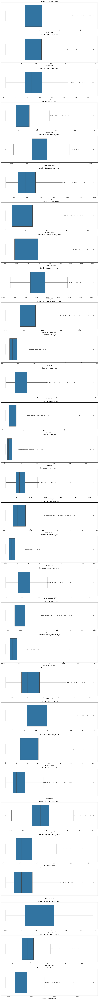

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

def generate_boxplots(data):

    numerical_columns = data.select_dtypes(include=['number']).columns

    plt.figure(figsize=(12, len(numerical_columns) * 4))
    for i, col in enumerate(numerical_columns, 1):
        plt.subplot(len(numerical_columns), 1, i)
        sns.boxplot(x=data[col])
        plt.title(f'Boxplot of {col}')
        plt.xlabel(col)

    plt.tight_layout()
    plt.show()

generate_boxplots(df)


#Removing Outliers

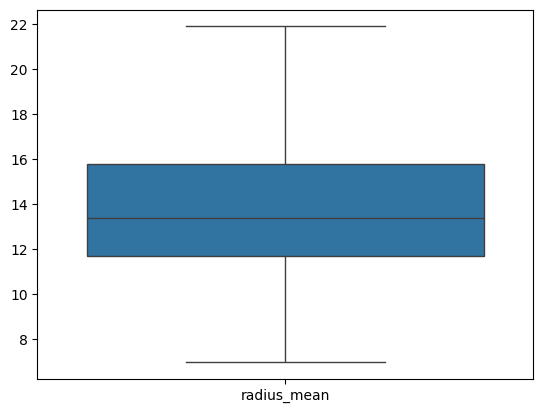

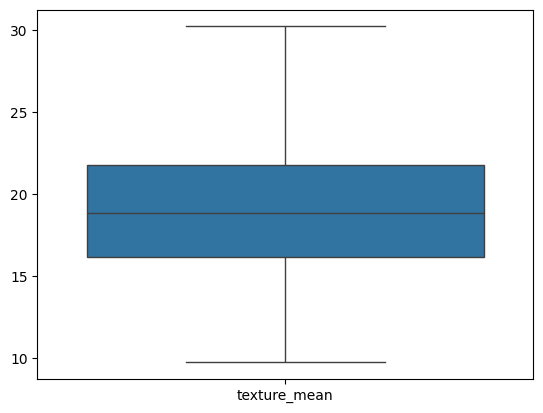

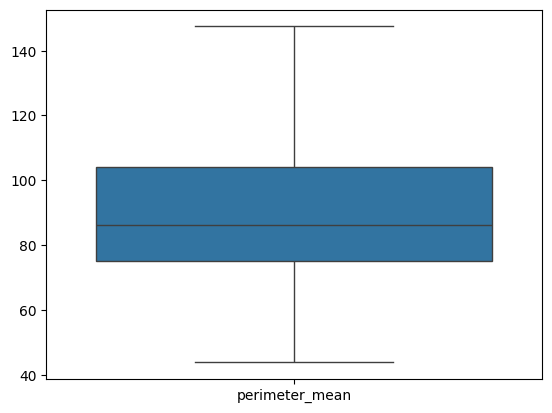

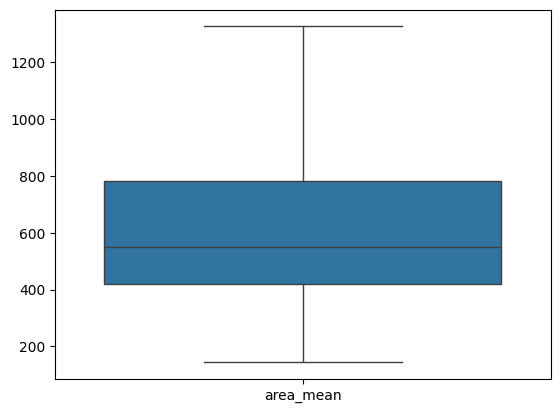

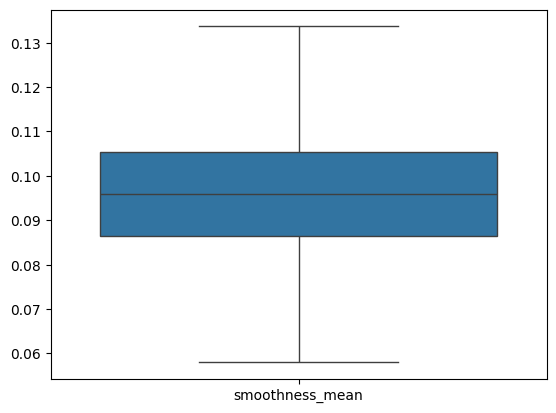

...

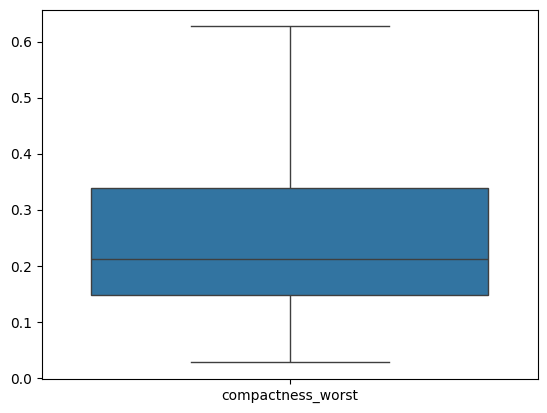

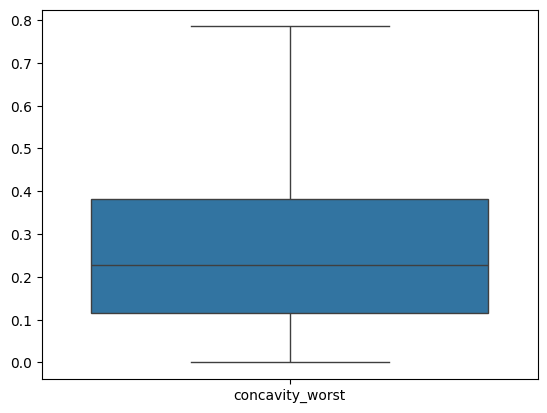

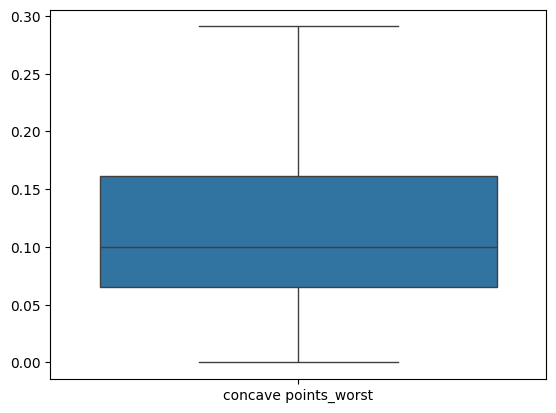

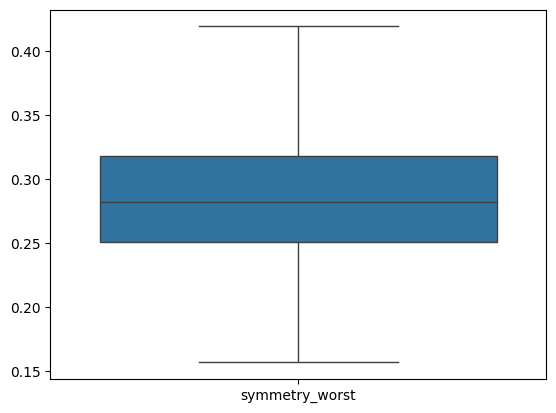

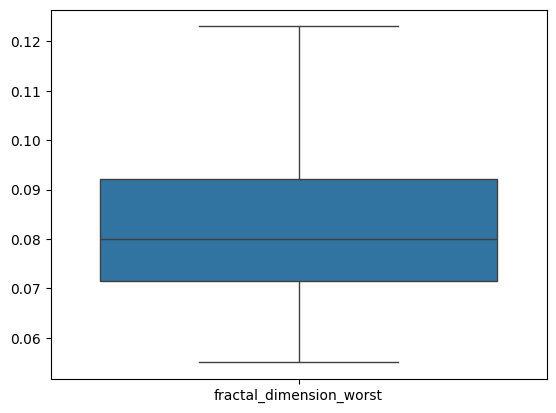

In [ ]:
def addressing_outliers(col):
  q1=df[col].quantile(0.25)
  q3=df[col].quantile(0.75)
  iqr=q3-q1
  lower_bound=q1-1.5*iqr
  upper_bound=q3+1.5*iqr
  outliers= df[df[col]<lower_bound]
  outliers= df[df[col]>upper_bound]
  df[col] = df[col].clip(lower=lower_bound, upper=upper_bound)
  sns.boxplot(df[[col]])
  plt.show()

num_df=df.select_dtypes(include=['number']).columns
for i, col in enumerate(num_df):
  addressing_outliers(col)

#Pairplot

In [ ]:
sns.pairplot(df)

#Visualizing Correlation

Text(0.5, 1.0, 'Correlation Heatmap')

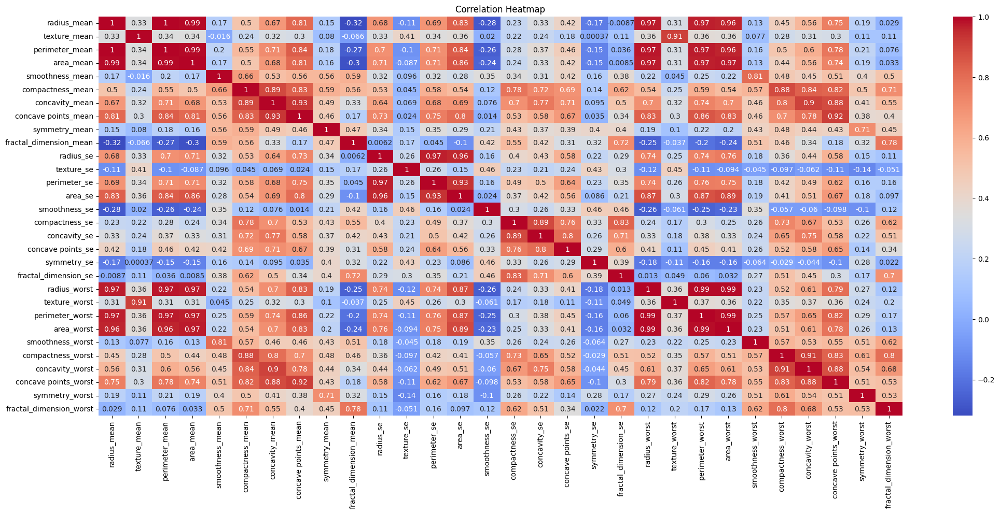

In [ ]:
numerical_df = df.select_dtypes(include=["number"])
corr=numerical_df.corr()
plt.figure(figsize=(25, 10))
sns.heatmap(corr, annot=True, cmap='coolwarm')
plt.title('Correlation Heatmap')

In [ ]:
df.columns

Index(['diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean',
       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst'],
      dtype='object')

In [ ]:
len(df.columns)

31

#Implementing ML models

In [ ]:
import numpy as np
import pandas as pd
import sklearn.metrics as metrics
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.neighbors import KNeighborsClassifier
from sklearn import svm
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import RandomForestClassifier
import xgboost as xgb
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.neural_network import MLPClassifier
from sklearn.cluster import KMeans
from sklearn import tree
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix,accuracy_score
from sklearn.model_selection import cross_validate
from sklearn.preprocessing import StandardScaler


In [ ]:
df['diagnosis'].unique()

array(['M', 'B'], dtype=object)

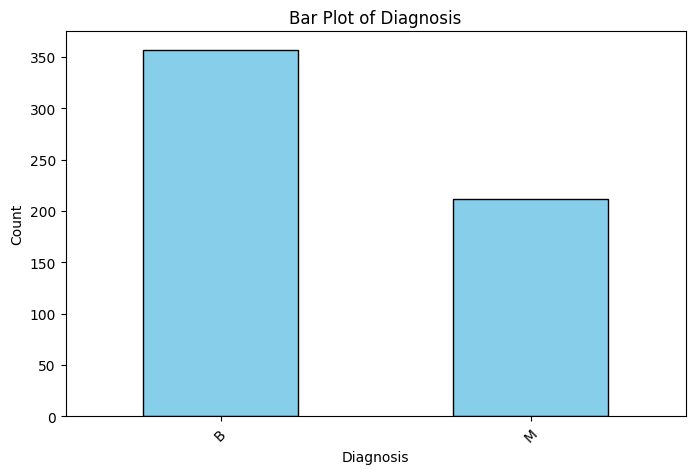

In [ ]:

value_counts = df['diagnosis'].value_counts()

# Plot the bar chart
plt.figure(figsize=(8, 5))
value_counts.plot(kind="bar", color="skyblue", edgecolor="black")

# Customize plot
plt.xlabel('Diagnosis')
plt.ylabel("Count")
plt.title(f"Bar Plot of Diagnosis")
plt.xticks(rotation=45)  # Rotate x-axis labels if necessary


# Show plot
plt.show()

#Splitting Dataset

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import StratifiedKFold, cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, roc_curve, auc, accuracy_score
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import LabelBinarizer



x= df[df.select_dtypes(include=["number"]).columns]
y= df['diagnosis']
lb = LabelBinarizer()
# y = lb.fit_transform(y)
# Normalize features
scaler = StandardScaler()
x = scaler.fit_transform(x)
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.25, shuffle=True)

#Extracting Features with ANN

In [ ]:
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow import keras
from sklearn.model_selection import StratifiedKFold
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import LabelBinarizer
lb = LabelBinarizer()


# Define target column name
target_column = "diagnosis"  # Replace with actual target column name

# Separate features (X) and target (y)
X = df.drop(columns=[target_column]).values  # Features
y = df[target_column].values  # Target
y = lb.fit_transform(y)
# Normalize features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)


# Stratified K-Fold Cross-Validation
skf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)
fold_accuracies = []

# Early Stopping Callback
early_stopping = keras.callbacks.EarlyStopping(
    monitor="val_loss",  # Monitor validation loss
    patience=5,  # Stop training if no improvement after 5 epochs
    restore_best_weights=True  # Restore the best model after stopping
)
# Function to create the model
def create_model():
    model = keras.Sequential([
        keras.layers.Dense(256, activation='relu', input_shape=(X.shape[1],)),
        keras.layers.Dense(64, activation='relu'),
        keras.layers.Dropout(0.25),
        keras.layers.Dense(1, activation='sigmoid')  # Binary classification
    ])
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model

# Perform cross-validation
for train_idx, val_idx in skf.split(X_scaled, y):
    X_train, X_val = X_scaled[train_idx], X_scaled[val_idx]
    y_train, y_val = y[train_idx], y[val_idx]

    model = create_model()
    model.fit(X_train, y_train, epochs=20, batch_size=32, verbose=0,validation_data=(X_val, y_val), callbacks=[early_stopping])

    # Evaluate on validation set
    loss, acc = model.evaluate(X_val, y_val, verbose=1)
    fold_accuracies.append(acc)

# Print average accuracy across folds
print(f"Mean Cross-Validation Accuracy: {np.mean(fold_accuracies):.4f}")


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - accuracy: 0.9662 - loss: 0.0385
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - accuracy: 1.0000 - loss: 0.0103
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - accuracy: 0.9779 - loss: 0.0385
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - accuracy: 0.9558 - loss: 0.1744
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - accuracy: 0.9558 - loss: 0.1633
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - accuracy: 0.9779 - loss: 0.0905
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - accuracy: 1.0000 - loss: 0.0019
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - accuracy: 0.9883 - loss: 0.0751
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - accuracy: 0.9779 - loss: 0.0659
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - accuracy: 1.0000 - loss: 0.0106
Mean Cross-Validation Accuracy: 0.9825


In [ ]:
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow.keras.models import Model
from sklearn.preprocessing import StandardScaler

feature_extractor = Model(inputs=model.layers[0].input, outputs=model.layers[-2].output)

# Extract features
X_features = feature_extractor.predict(X_scaled)

# Print shape of extracted features
print("Extracted Feature Shape:", X_features.shape)  # Should be (num_samples, 64)

x= X_features
y=df['diagnosis']
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.25, shuffle=True)


18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Extracted Feature Shape: (569, 64)


# Gaussian Naive Baiyes Without Extracted Features

Accuracy: 0.9371
Classification Report:
               precision    recall  f1-score   support

           B       0.96      0.95      0.95        91
           M       0.91      0.92      0.91        52

    accuracy                           0.94       143
   macro avg       0.93      0.93      0.93       143
weighted avg       0.94      0.94      0.94       143

Cross-Validation Accuracy: 0.9349



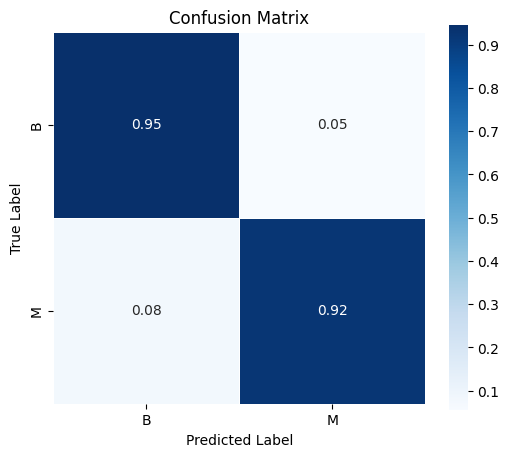

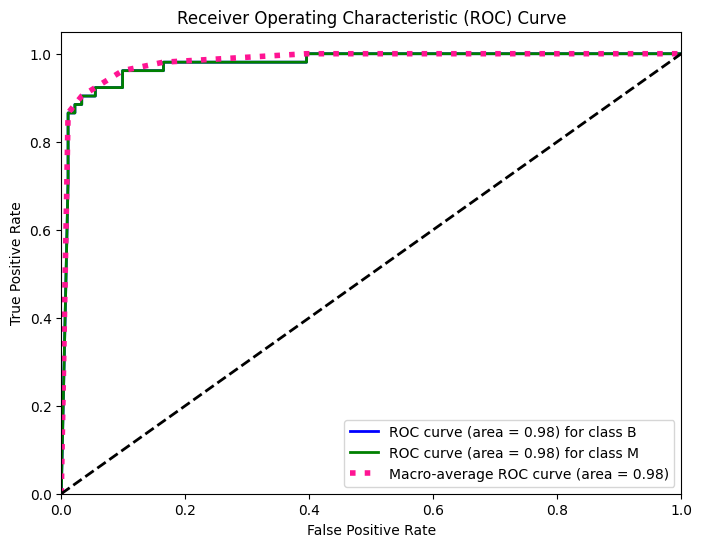

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report
from itertools import cycle
from sklearn.preprocessing import LabelBinarizer



rf_model = GaussianNB()
rf_model.fit(x_train, y_train)


y_pred = rf_model.predict(x_test)


accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy:.4f}')
print('Classification Report:\n', classification_report(y_test, y_pred))

skf = StratifiedKFold(n_splits=10, shuffle=True)
cv_scores = cross_val_score(rf_model, x, y, cv=skf, scoring='accuracy')

print(f'Cross-Validation Accuracy: {np.mean(cv_scores):.4f}')
print()

y_pred = rf_model.predict(x_test)
y_probs = rf_model.predict_proba(x_test)[:, 1]


class_names = np.unique(y)

# Function to plot Confusion Matrix
def plot_confusion_matrix(y_true, y_pred, class_names):
    cm = confusion_matrix(y_true, y_pred)
    cm_norm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]  # Normalize

    plt.figure(figsize=(6, 5))
    sns.heatmap(cm_norm, annot=True, fmt='.2f', cmap='Blues', linewidths=0.5, square=True,
                xticklabels=class_names, yticklabels=class_names)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title('Confusion Matrix')
    plt.show()

plot_confusion_matrix(y_test, y_pred, class_names)

# Function to plot ROC Curve
lb = LabelBinarizer()
y_test_bin = lb.fit_transform(y_test)
fpr, tpr, roc_auc = {}, {}, {}


for i in range(len(class_names)):
  y_test_bin = y_test_bin.reshape(-1, 1)
  fpr[i], tpr[i], _ = roc_curve(y_test_bin, y_probs)
  roc_auc[i] = auc(fpr[i], tpr[i])

# Compute macro-average ROC curve
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(len(class_names))]))
mean_tpr = np.zeros_like(all_fpr)
for i in range(len(class_names)):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
mean_tpr /= len(class_names)
fpr['macro'], tpr['macro'] = all_fpr, mean_tpr
roc_auc['macro'] = auc(fpr['macro'], tpr['macro'])

# Plot ROC Curves
plt.figure(figsize=(8, 6))
colors = cycle(['blue', 'green', 'red', 'cyan', 'magenta', 'yellow'])
for i, color in zip(range(len(class_names)), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2, label=f'ROC curve (area = {roc_auc[i]:.2f}) for class {class_names[i]}')

plt.plot(fpr['macro'], tpr['macro'], color='deeppink', linestyle=':', linewidth=4,
         label=f'Macro-average ROC curve (area = {roc_auc["macro"]:.2f})')
plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.show()


# Gaussian Naive Baiyes With Extracted Features

Accuracy: 1.0000
Classification Report:
               precision    recall  f1-score   support

           B       1.00      1.00      1.00        84
           M       1.00      1.00      1.00        59

    accuracy                           1.00       143
   macro avg       1.00      1.00      1.00       143
weighted avg       1.00      1.00      1.00       143

Cross-Validation Accuracy: 0.9982



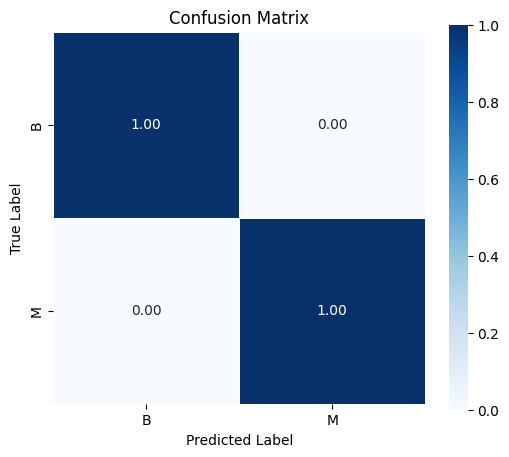

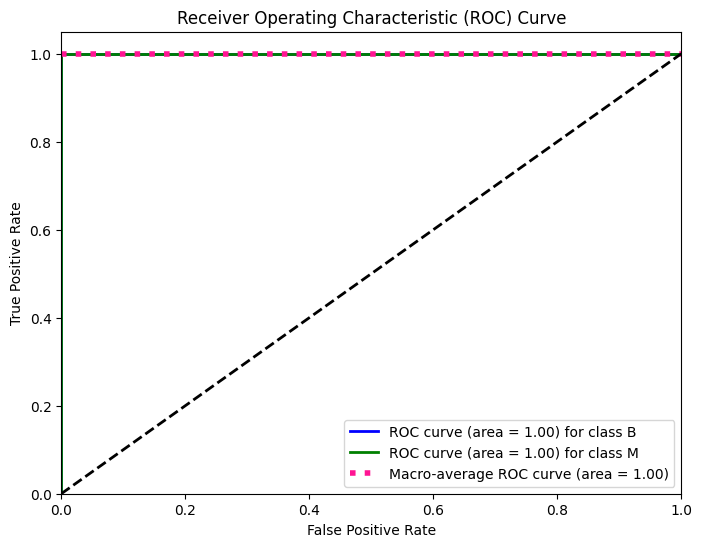

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report
from itertools import cycle
from sklearn.preprocessing import LabelBinarizer



rf_model = GaussianNB()
rf_model.fit(x_train, y_train)


y_pred = rf_model.predict(x_test)


accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy:.4f}')
print('Classification Report:\n', classification_report(y_test, y_pred))

skf = StratifiedKFold(n_splits=10, shuffle=True)
cv_scores = cross_val_score(rf_model, x, y, cv=skf, scoring='accuracy')

print(f'Cross-Validation Accuracy: {np.mean(cv_scores):.4f}')
print()

y_pred = rf_model.predict(x_test)
y_probs = rf_model.predict_proba(x_test)[:, 1]


class_names = np.unique(y)

# Function to plot Confusion Matrix
def plot_confusion_matrix(y_true, y_pred, class_names):
    cm = confusion_matrix(y_true, y_pred)
    cm_norm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]  # Normalize

    plt.figure(figsize=(6, 5))
    sns.heatmap(cm_norm, annot=True, fmt='.2f', cmap='Blues', linewidths=0.5, square=True,
                xticklabels=class_names, yticklabels=class_names)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title('Confusion Matrix')
    plt.show()

plot_confusion_matrix(y_test, y_pred, class_names)

# Function to plot ROC Curve
lb = LabelBinarizer()
y_test_bin = lb.fit_transform(y_test)
fpr, tpr, roc_auc = {}, {}, {}


for i in range(len(class_names)):
  y_test_bin = y_test_bin.reshape(-1, 1)
  fpr[i], tpr[i], _ = roc_curve(y_test_bin, y_probs)
  roc_auc[i] = auc(fpr[i], tpr[i])

# Compute macro-average ROC curve
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(len(class_names))]))
mean_tpr = np.zeros_like(all_fpr)
for i in range(len(class_names)):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
mean_tpr /= len(class_names)
fpr['macro'], tpr['macro'] = all_fpr, mean_tpr
roc_auc['macro'] = auc(fpr['macro'], tpr['macro'])

# Plot ROC Curves
plt.figure(figsize=(8, 6))
colors = cycle(['blue', 'green', 'red', 'cyan', 'magenta', 'yellow'])
for i, color in zip(range(len(class_names)), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2, label=f'ROC curve (area = {roc_auc[i]:.2f}) for class {class_names[i]}')

plt.plot(fpr['macro'], tpr['macro'], color='deeppink', linestyle=':', linewidth=4,
         label=f'Macro-average ROC curve (area = {roc_auc["macro"]:.2f})')
plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.show()


# RandomForestClassifier Without Extracted Features

Accuracy: 0.9580
Classification Report:
               precision    recall  f1-score   support

           0       0.95      0.98      0.96        83
           1       0.97      0.93      0.95        60

    accuracy                           0.96       143
   macro avg       0.96      0.95      0.96       143
weighted avg       0.96      0.96      0.96       143

Cross-Validation Accuracy: 0.9614



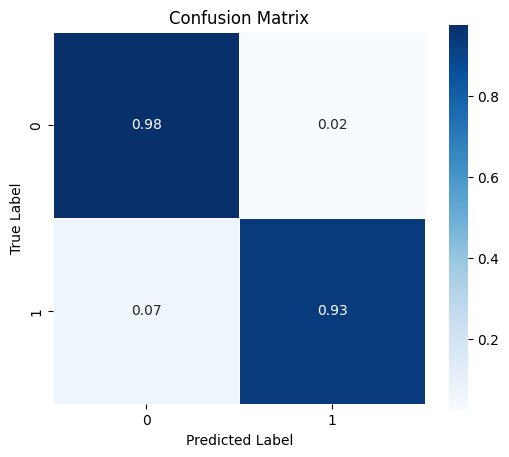

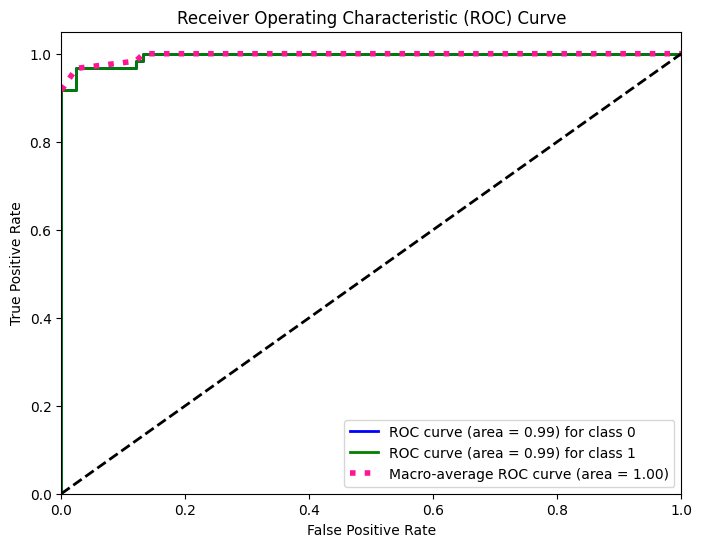

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report
from itertools import cycle
from sklearn.preprocessing import LabelBinarizer



rf_model = RandomForestClassifier(n_estimators=500, min_samples_split=4)
rf_model.fit(x_train, y_train)


y_pred = rf_model.predict(x_test)


accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy:.4f}')
print('Classification Report:\n', classification_report(y_test, y_pred))

skf = StratifiedKFold(n_splits=10, shuffle=True)
cv_scores = cross_val_score(rf_model, x, y, cv=skf, scoring='accuracy')

print(f'Cross-Validation Accuracy: {np.mean(cv_scores):.4f}')
print()

y_pred = rf_model.predict(x_test)
y_probs = rf_model.predict_proba(x_test)[:, 1]


class_names = np.unique(y)

# Function to plot Confusion Matrix
def plot_confusion_matrix(y_true, y_pred, class_names):
    cm = confusion_matrix(y_true, y_pred)
    cm_norm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]  # Normalize

    plt.figure(figsize=(6, 5))
    sns.heatmap(cm_norm, annot=True, fmt='.2f', cmap='Blues', linewidths=0.5, square=True,
                xticklabels=class_names, yticklabels=class_names)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title('Confusion Matrix')
    plt.show()

plot_confusion_matrix(y_test, y_pred, class_names)

# Function to plot ROC Curve
lb = LabelBinarizer()
y_test_bin = lb.fit_transform(y_test)
fpr, tpr, roc_auc = {}, {}, {}


for i in range(len(class_names)):
  y_test_bin = y_test_bin.reshape(-1, 1)
  fpr[i], tpr[i], _ = roc_curve(y_test_bin, y_probs)
  roc_auc[i] = auc(fpr[i], tpr[i])

# Compute macro-average ROC curve
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(len(class_names))]))
mean_tpr = np.zeros_like(all_fpr)
for i in range(len(class_names)):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
mean_tpr /= len(class_names)
fpr['macro'], tpr['macro'] = all_fpr, mean_tpr
roc_auc['macro'] = auc(fpr['macro'], tpr['macro'])

# Plot ROC Curves
plt.figure(figsize=(8, 6))
colors = cycle(['blue', 'green', 'red', 'cyan', 'magenta', 'yellow'])
for i, color in zip(range(len(class_names)), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2, label=f'ROC curve (area = {roc_auc[i]:.2f}) for class {class_names[i]}')

plt.plot(fpr['macro'], tpr['macro'], color='deeppink', linestyle=':', linewidth=4,
         label=f'Macro-average ROC curve (area = {roc_auc["macro"]:.2f})')
plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.show()


# RandomForestClassifier With Extracted Features

Accuracy: 1.0000
Classification Report:
               precision    recall  f1-score   support

           B       1.00      1.00      1.00        96
           M       1.00      1.00      1.00        47

    accuracy                           1.00       143
   macro avg       1.00      1.00      1.00       143
weighted avg       1.00      1.00      1.00       143

Cross-Validation Accuracy: 0.9982



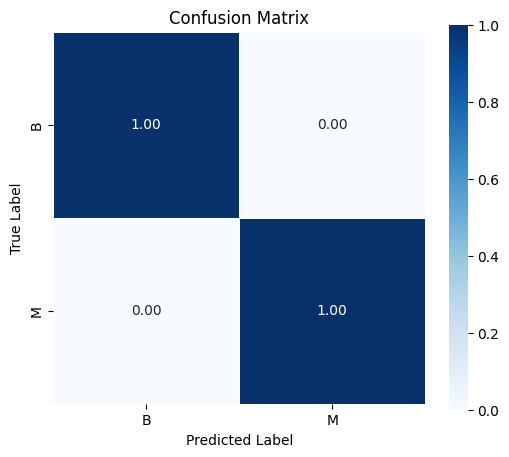

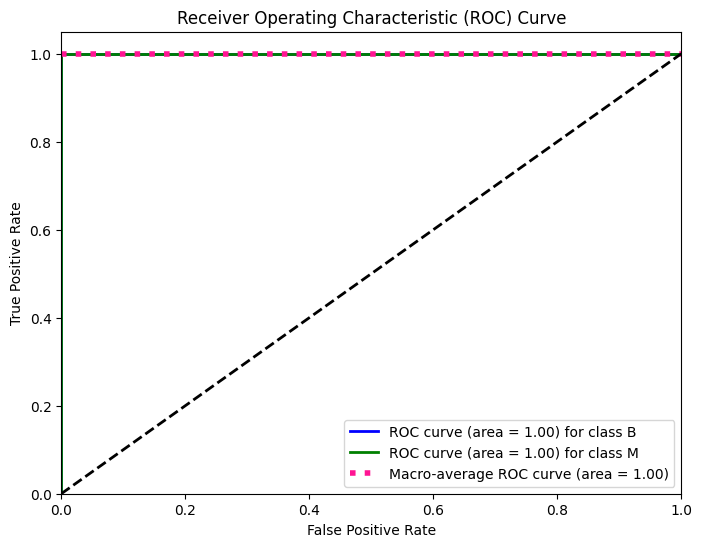

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report
from itertools import cycle
from sklearn.preprocessing import LabelBinarizer



rf_model = RandomForestClassifier(n_estimators=500, min_samples_split=4)
rf_model.fit(x_train, y_train)


y_pred = rf_model.predict(x_test)


accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy:.4f}')
print('Classification Report:\n', classification_report(y_test, y_pred))

skf = StratifiedKFold(n_splits=10, shuffle=True)
cv_scores = cross_val_score(rf_model, x, y, cv=skf, scoring='accuracy')

print(f'Cross-Validation Accuracy: {np.mean(cv_scores):.4f}')
print()

y_pred = rf_model.predict(x_test)
y_probs = rf_model.predict_proba(x_test)[:, 1]


class_names = np.unique(y)

# Function to plot Confusion Matrix
def plot_confusion_matrix(y_true, y_pred, class_names):
    cm = confusion_matrix(y_true, y_pred)
    cm_norm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]  # Normalize

    plt.figure(figsize=(6, 5))
    sns.heatmap(cm_norm, annot=True, fmt='.2f', cmap='Blues', linewidths=0.5, square=True,
                xticklabels=class_names, yticklabels=class_names)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title('Confusion Matrix')
    plt.show()

plot_confusion_matrix(y_test, y_pred, class_names)

# Function to plot ROC Curve
lb = LabelBinarizer()
y_test_bin = lb.fit_transform(y_test)
fpr, tpr, roc_auc = {}, {}, {}


for i in range(len(class_names)):
  y_test_bin = y_test_bin.reshape(-1, 1)
  fpr[i], tpr[i], _ = roc_curve(y_test_bin, y_probs)
  roc_auc[i] = auc(fpr[i], tpr[i])

# Compute macro-average ROC curve
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(len(class_names))]))
mean_tpr = np.zeros_like(all_fpr)
for i in range(len(class_names)):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
mean_tpr /= len(class_names)
fpr['macro'], tpr['macro'] = all_fpr, mean_tpr
roc_auc['macro'] = auc(fpr['macro'], tpr['macro'])

# Plot ROC Curves
plt.figure(figsize=(8, 6))
colors = cycle(['blue', 'green', 'red', 'cyan', 'magenta', 'yellow'])
for i, color in zip(range(len(class_names)), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2, label=f'ROC curve (area = {roc_auc[i]:.2f}) for class {class_names[i]}')

plt.plot(fpr['macro'], tpr['macro'], color='deeppink', linestyle=':', linewidth=4,
         label=f'Macro-average ROC curve (area = {roc_auc["macro"]:.2f})')
plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.show()


# DecisionTreeClassifier Without Extracted Features

Accuracy: 0.9231
Classification Report:
               precision    recall  f1-score   support

           0       0.95      0.92      0.93        83
           1       0.89      0.93      0.91        60

    accuracy                           0.92       143
   macro avg       0.92      0.92      0.92       143
weighted avg       0.92      0.92      0.92       143

Cross-Validation Accuracy: 0.9385



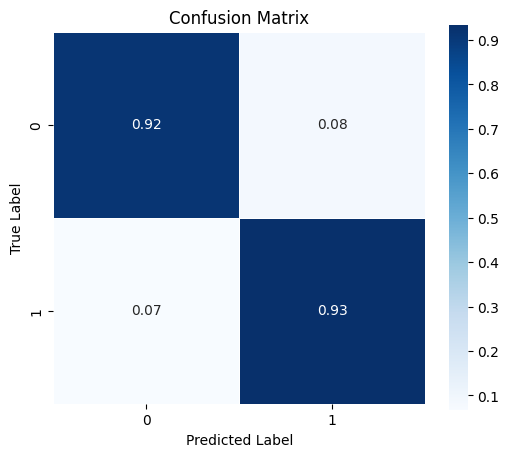

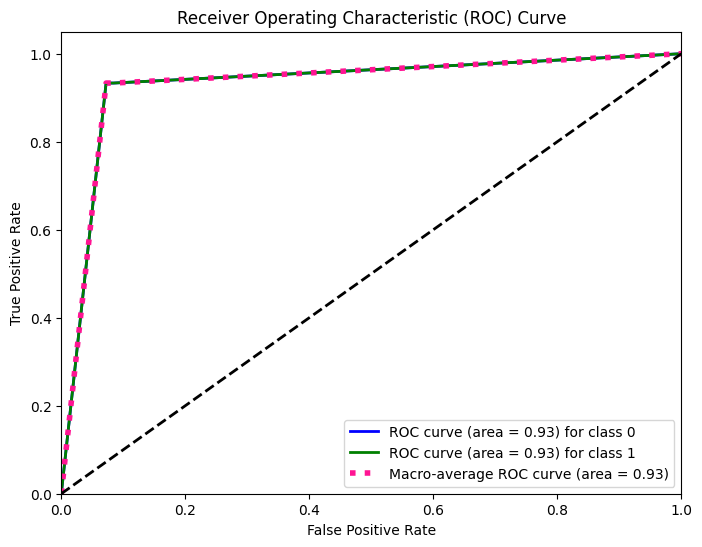

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, classification_report
from itertools import cycle
from sklearn.preprocessing import LabelBinarizer



rf_model = DecisionTreeClassifier( criterion='entropy', min_samples_split=4)
rf_model.fit(x_train, y_train)


y_pred = rf_model.predict(x_test)


accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy:.4f}')
print('Classification Report:\n', classification_report(y_test, y_pred))

skf = StratifiedKFold(n_splits=10, shuffle=True)
cv_scores = cross_val_score(rf_model, x, y, cv=skf, scoring='accuracy')

print(f'Cross-Validation Accuracy: {np.mean(cv_scores):.4f}')
print()

y_pred = rf_model.predict(x_test)
y_probs = rf_model.predict_proba(x_test)[:, 1]


class_names = np.unique(y)

# Function to plot Confusion Matrix
def plot_confusion_matrix(y_true, y_pred, class_names):
    cm = confusion_matrix(y_true, y_pred)
    cm_norm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]  # Normalize

    plt.figure(figsize=(6, 5))
    sns.heatmap(cm_norm, annot=True, fmt='.2f', cmap='Blues', linewidths=0.5, square=True,
                xticklabels=class_names, yticklabels=class_names)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title('Confusion Matrix')
    plt.show()

plot_confusion_matrix(y_test, y_pred, class_names)

# Function to plot ROC Curve
lb = LabelBinarizer()
y_test_bin = lb.fit_transform(y_test)
fpr, tpr, roc_auc = {}, {}, {}


for i in range(len(class_names)):
  y_test_bin = y_test_bin.reshape(-1, 1)
  fpr[i], tpr[i], _ = roc_curve(y_test_bin, y_probs)
  roc_auc[i] = auc(fpr[i], tpr[i])

# Compute macro-average ROC curve
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(len(class_names))]))
mean_tpr = np.zeros_like(all_fpr)
for i in range(len(class_names)):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
mean_tpr /= len(class_names)
fpr['macro'], tpr['macro'] = all_fpr, mean_tpr
roc_auc['macro'] = auc(fpr['macro'], tpr['macro'])

# Plot ROC Curves
plt.figure(figsize=(8, 6))
colors = cycle(['blue', 'green', 'red', 'cyan', 'magenta', 'yellow'])
for i, color in zip(range(len(class_names)), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2, label=f'ROC curve (area = {roc_auc[i]:.2f}) for class {class_names[i]}')

plt.plot(fpr['macro'], tpr['macro'], color='deeppink', linestyle=':', linewidth=4,
         label=f'Macro-average ROC curve (area = {roc_auc["macro"]:.2f})')
plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.show()


# DecisionTreeClassifier With Extracted Features

Accuracy: 0.9860
Classification Report:
               precision    recall  f1-score   support

           B       1.00      0.98      0.99        96
           M       0.96      1.00      0.98        47

    accuracy                           0.99       143
   macro avg       0.98      0.99      0.98       143
weighted avg       0.99      0.99      0.99       143

Cross-Validation Accuracy: 0.9947



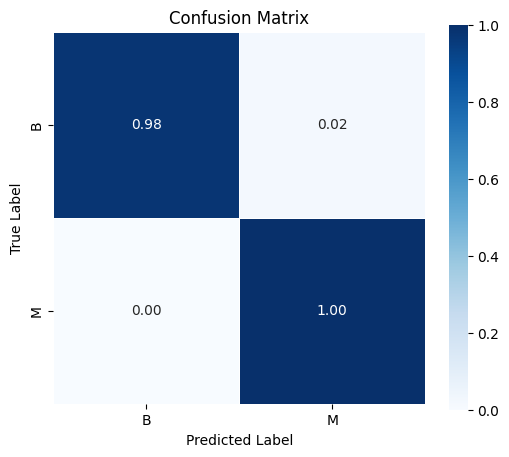

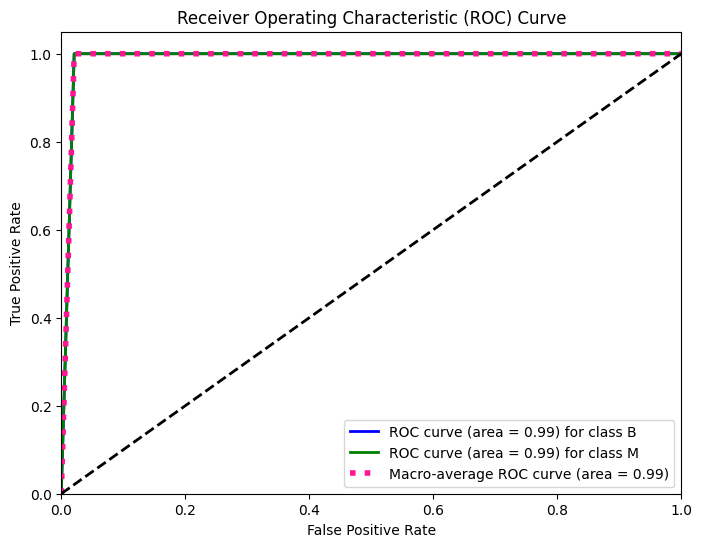

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, classification_report
from itertools import cycle
from sklearn.preprocessing import LabelBinarizer



rf_model = DecisionTreeClassifier( criterion='entropy', min_samples_split=4)
rf_model.fit(x_train, y_train)


y_pred = rf_model.predict(x_test)


accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy:.4f}')
print('Classification Report:\n', classification_report(y_test, y_pred))

skf = StratifiedKFold(n_splits=10, shuffle=True)
cv_scores = cross_val_score(rf_model, x, y, cv=skf, scoring='accuracy')

print(f'Cross-Validation Accuracy: {np.mean(cv_scores):.4f}')
print()

y_pred = rf_model.predict(x_test)
y_probs = rf_model.predict_proba(x_test)[:, 1]


class_names = np.unique(y)

# Function to plot Confusion Matrix
def plot_confusion_matrix(y_true, y_pred, class_names):
    cm = confusion_matrix(y_true, y_pred)
    cm_norm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]  # Normalize

    plt.figure(figsize=(6, 5))
    sns.heatmap(cm_norm, annot=True, fmt='.2f', cmap='Blues', linewidths=0.5, square=True,
                xticklabels=class_names, yticklabels=class_names)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title('Confusion Matrix')
    plt.show()

plot_confusion_matrix(y_test, y_pred, class_names)

# Function to plot ROC Curve
lb = LabelBinarizer()
y_test_bin = lb.fit_transform(y_test)
fpr, tpr, roc_auc = {}, {}, {}


for i in range(len(class_names)):
  y_test_bin = y_test_bin.reshape(-1, 1)
  fpr[i], tpr[i], _ = roc_curve(y_test_bin, y_probs)
  roc_auc[i] = auc(fpr[i], tpr[i])

# Compute macro-average ROC curve
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(len(class_names))]))
mean_tpr = np.zeros_like(all_fpr)
for i in range(len(class_names)):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
mean_tpr /= len(class_names)
fpr['macro'], tpr['macro'] = all_fpr, mean_tpr
roc_auc['macro'] = auc(fpr['macro'], tpr['macro'])

# Plot ROC Curves
plt.figure(figsize=(8, 6))
colors = cycle(['blue', 'green', 'red', 'cyan', 'magenta', 'yellow'])
for i, color in zip(range(len(class_names)), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2, label=f'ROC curve (area = {roc_auc[i]:.2f}) for class {class_names[i]}')

plt.plot(fpr['macro'], tpr['macro'], color='deeppink', linestyle=':', linewidth=4,
         label=f'Macro-average ROC curve (area = {roc_auc["macro"]:.2f})')
plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.show()


#KNeighborsClassifier Without Extracted Features

Accuracy: 0.9580
Classification Report:
               precision    recall  f1-score   support

           0       0.94      0.99      0.96        83
           1       0.98      0.92      0.95        60

    accuracy                           0.96       143
   macro avg       0.96      0.95      0.96       143
weighted avg       0.96      0.96      0.96       143

Cross-Validation Accuracy: 0.9683



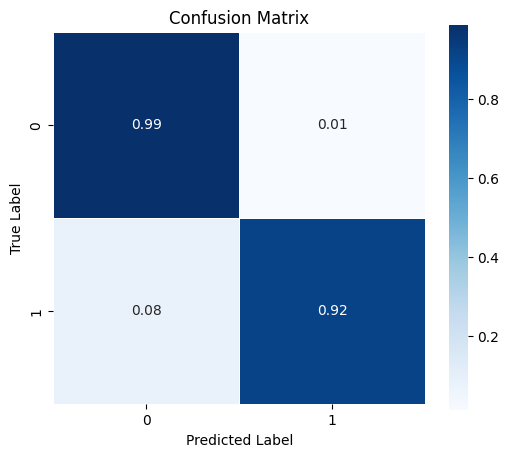

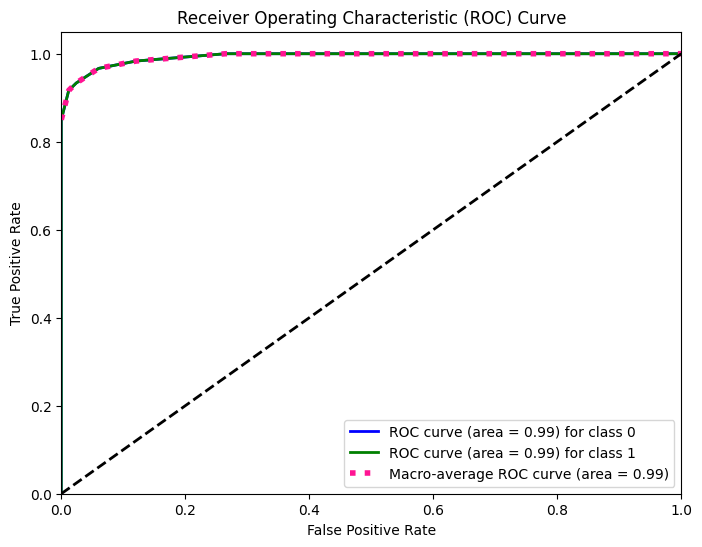

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score, classification_report
from itertools import cycle
from sklearn.preprocessing import LabelBinarizer



rf_model = KNeighborsClassifier(n_neighbors=10, leaf_size=50)
rf_model.fit(x_train, y_train)


y_pred = rf_model.predict(x_test)


accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy:.4f}')
print('Classification Report:\n', classification_report(y_test, y_pred))

skf = StratifiedKFold(n_splits=10, shuffle=True)
cv_scores = cross_val_score(rf_model, x, y, cv=skf, scoring='accuracy')

print(f'Cross-Validation Accuracy: {np.mean(cv_scores):.4f}')
print()

y_pred = rf_model.predict(x_test)
y_probs = rf_model.predict_proba(x_test)[:, 1]


class_names = np.unique(y)

# Function to plot Confusion Matrix
def plot_confusion_matrix(y_true, y_pred, class_names):
    cm = confusion_matrix(y_true, y_pred)
    cm_norm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]  # Normalize

    plt.figure(figsize=(6, 5))
    sns.heatmap(cm_norm, annot=True, fmt='.2f', cmap='Blues', linewidths=0.5, square=True,
                xticklabels=class_names, yticklabels=class_names)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title('Confusion Matrix')
    plt.show()

plot_confusion_matrix(y_test, y_pred, class_names)

# Function to plot ROC Curve
lb = LabelBinarizer()
y_test_bin = lb.fit_transform(y_test)
fpr, tpr, roc_auc = {}, {}, {}


for i in range(len(class_names)):
  y_test_bin = y_test_bin.reshape(-1, 1)
  fpr[i], tpr[i], _ = roc_curve(y_test_bin, y_probs)
  roc_auc[i] = auc(fpr[i], tpr[i])

# Compute macro-average ROC curve
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(len(class_names))]))
mean_tpr = np.zeros_like(all_fpr)
for i in range(len(class_names)):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
mean_tpr /= len(class_names)
fpr['macro'], tpr['macro'] = all_fpr, mean_tpr
roc_auc['macro'] = auc(fpr['macro'], tpr['macro'])

# Plot ROC Curves
plt.figure(figsize=(8, 6))
colors = cycle(['blue', 'green', 'red', 'cyan', 'magenta', 'yellow'])
for i, color in zip(range(len(class_names)), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2, label=f'ROC curve (area = {roc_auc[i]:.2f}) for class {class_names[i]}')

plt.plot(fpr['macro'], tpr['macro'], color='deeppink', linestyle=':', linewidth=4,
         label=f'Macro-average ROC curve (area = {roc_auc["macro"]:.2f})')
plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.show()


#KNeighborsClassifier With Extracted Features

Accuracy: 0.9930
Classification Report:
               precision    recall  f1-score   support

           B       0.99      1.00      0.99        96
           M       1.00      0.98      0.99        47

    accuracy                           0.99       143
   macro avg       0.99      0.99      0.99       143
weighted avg       0.99      0.99      0.99       143

Cross-Validation Accuracy: 0.9965



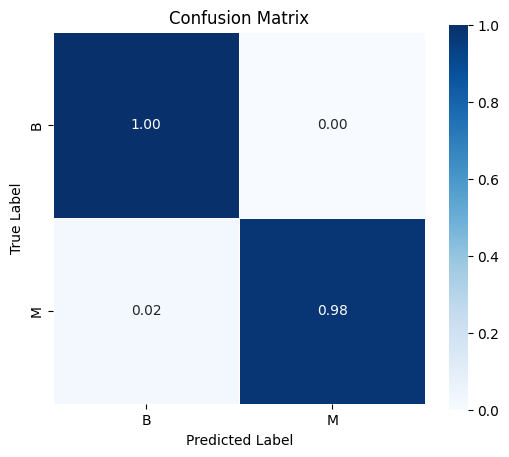

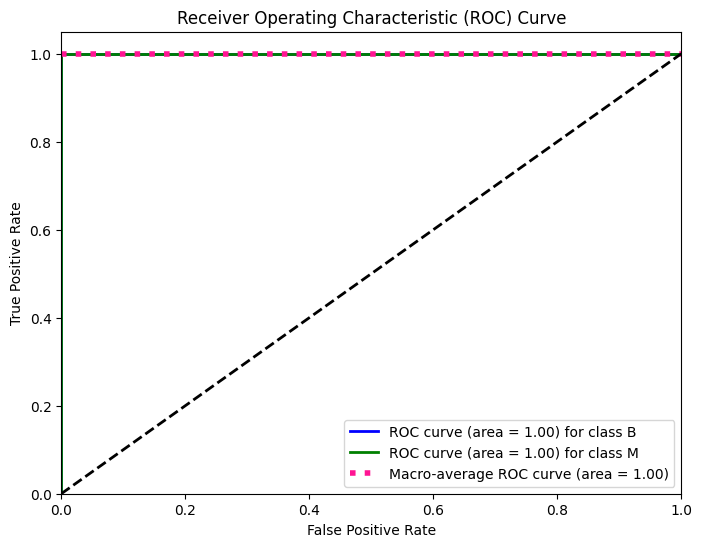

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score, classification_report
from itertools import cycle
from sklearn.preprocessing import LabelBinarizer



rf_model = KNeighborsClassifier(n_neighbors=10, leaf_size=50)
rf_model.fit(x_train, y_train)


y_pred = rf_model.predict(x_test)


accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy:.4f}')
print('Classification Report:\n', classification_report(y_test, y_pred))

skf = StratifiedKFold(n_splits=10, shuffle=True)
cv_scores = cross_val_score(rf_model, x, y, cv=skf, scoring='accuracy')

print(f'Cross-Validation Accuracy: {np.mean(cv_scores):.4f}')
print()

y_pred = rf_model.predict(x_test)
y_probs = rf_model.predict_proba(x_test)[:, 1]


class_names = np.unique(y)

# Function to plot Confusion Matrix
def plot_confusion_matrix(y_true, y_pred, class_names):
    cm = confusion_matrix(y_true, y_pred)
    cm_norm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]  # Normalize

    plt.figure(figsize=(6, 5))
    sns.heatmap(cm_norm, annot=True, fmt='.2f', cmap='Blues', linewidths=0.5, square=True,
                xticklabels=class_names, yticklabels=class_names)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title('Confusion Matrix')
    plt.show()

plot_confusion_matrix(y_test, y_pred, class_names)

# Function to plot ROC Curve
lb = LabelBinarizer()
y_test_bin = lb.fit_transform(y_test)
fpr, tpr, roc_auc = {}, {}, {}


for i in range(len(class_names)):
  y_test_bin = y_test_bin.reshape(-1, 1)
  fpr[i], tpr[i], _ = roc_curve(y_test_bin, y_probs)
  roc_auc[i] = auc(fpr[i], tpr[i])

# Compute macro-average ROC curve
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(len(class_names))]))
mean_tpr = np.zeros_like(all_fpr)
for i in range(len(class_names)):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
mean_tpr /= len(class_names)
fpr['macro'], tpr['macro'] = all_fpr, mean_tpr
roc_auc['macro'] = auc(fpr['macro'], tpr['macro'])

# Plot ROC Curves
plt.figure(figsize=(8, 6))
colors = cycle(['blue', 'green', 'red', 'cyan', 'magenta', 'yellow'])
for i, color in zip(range(len(class_names)), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2, label=f'ROC curve (area = {roc_auc[i]:.2f}) for class {class_names[i]}')

plt.plot(fpr['macro'], tpr['macro'], color='deeppink', linestyle=':', linewidth=4,
         label=f'Macro-average ROC curve (area = {roc_auc["macro"]:.2f})')
plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.show()


#LogisticRegression Without Extracted Features

Accuracy: 0.9650
Classification Report:
               precision    recall  f1-score   support

           0       0.94      1.00      0.97        83
           1       1.00      0.92      0.96        60

    accuracy                           0.97       143
   macro avg       0.97      0.96      0.96       143
weighted avg       0.97      0.97      0.96       143

Cross-Validation Accuracy: 0.9824



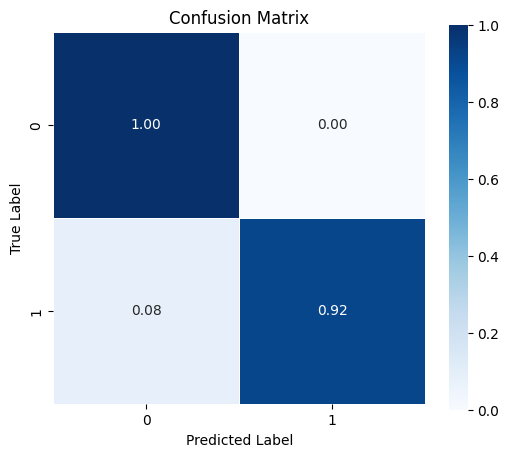

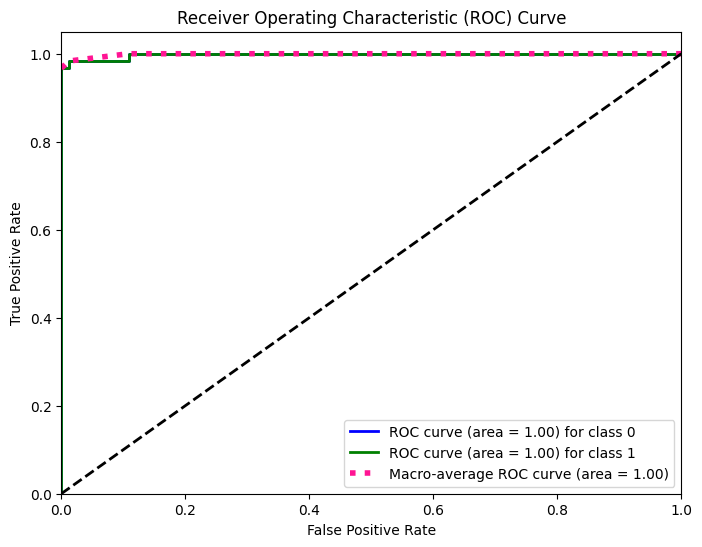

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report
from itertools import cycle
from sklearn.preprocessing import LabelBinarizer



rf_model = LogisticRegression(penalty='l2', solver="newton-cg")
rf_model.fit(x_train, y_train)


y_pred = rf_model.predict(x_test)


accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy:.4f}')
print('Classification Report:\n', classification_report(y_test, y_pred))

skf = StratifiedKFold(n_splits=10, shuffle=True)
cv_scores = cross_val_score(rf_model, x, y, cv=skf, scoring='accuracy')

print(f'Cross-Validation Accuracy: {np.mean(cv_scores):.4f}')
print()

y_pred = rf_model.predict(x_test)
y_probs = rf_model.predict_proba(x_test)[:, 1]


class_names = np.unique(y)

# Function to plot Confusion Matrix
def plot_confusion_matrix(y_true, y_pred, class_names):
    cm = confusion_matrix(y_true, y_pred)
    cm_norm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]  # Normalize

    plt.figure(figsize=(6, 5))
    sns.heatmap(cm_norm, annot=True, fmt='.2f', cmap='Blues', linewidths=0.5, square=True,
                xticklabels=class_names, yticklabels=class_names)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title('Confusion Matrix')
    plt.show()

plot_confusion_matrix(y_test, y_pred, class_names)

# Function to plot ROC Curve
lb = LabelBinarizer()
y_test_bin = lb.fit_transform(y_test)
fpr, tpr, roc_auc = {}, {}, {}


for i in range(len(class_names)):
  y_test_bin = y_test_bin.reshape(-1, 1)
  fpr[i], tpr[i], _ = roc_curve(y_test_bin, y_probs)
  roc_auc[i] = auc(fpr[i], tpr[i])

# Compute macro-average ROC curve
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(len(class_names))]))
mean_tpr = np.zeros_like(all_fpr)
for i in range(len(class_names)):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
mean_tpr /= len(class_names)
fpr['macro'], tpr['macro'] = all_fpr, mean_tpr
roc_auc['macro'] = auc(fpr['macro'], tpr['macro'])

# Plot ROC Curves
plt.figure(figsize=(8, 6))
colors = cycle(['blue', 'green', 'red', 'cyan', 'magenta', 'yellow'])
for i, color in zip(range(len(class_names)), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2, label=f'ROC curve (area = {roc_auc[i]:.2f}) for class {class_names[i]}')

plt.plot(fpr['macro'], tpr['macro'], color='deeppink', linestyle=':', linewidth=4,
         label=f'Macro-average ROC curve (area = {roc_auc["macro"]:.2f})')
plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.show()


#LogisticRegression With Extracted Features

Accuracy: 1.0000
Classification Report:
               precision    recall  f1-score   support

           B       1.00      1.00      1.00        96
           M       1.00      1.00      1.00        47

    accuracy                           1.00       143
   macro avg       1.00      1.00      1.00       143
weighted avg       1.00      1.00      1.00       143

Cross-Validation Accuracy: 0.9982



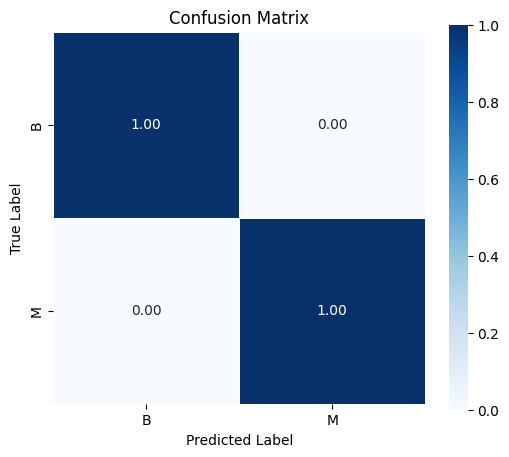

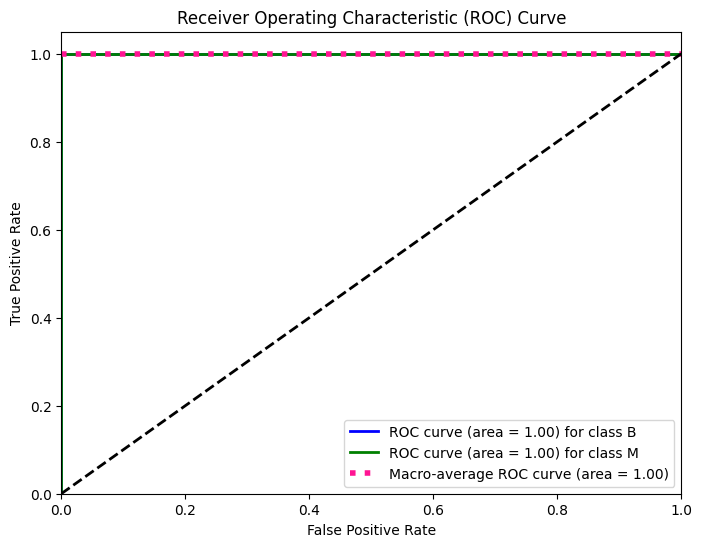

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report
from itertools import cycle
from sklearn.preprocessing import LabelBinarizer



rf_model = LogisticRegression(penalty='l2', solver="newton-cg")
rf_model.fit(x_train, y_train)


y_pred = rf_model.predict(x_test)


accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy:.4f}')
print('Classification Report:\n', classification_report(y_test, y_pred))

skf = StratifiedKFold(n_splits=10, shuffle=True)
cv_scores = cross_val_score(rf_model, x, y, cv=skf, scoring='accuracy')

print(f'Cross-Validation Accuracy: {np.mean(cv_scores):.4f}')
print()

y_pred = rf_model.predict(x_test)
y_probs = rf_model.predict_proba(x_test)[:, 1]


class_names = np.unique(y)

# Function to plot Confusion Matrix
def plot_confusion_matrix(y_true, y_pred, class_names):
    cm = confusion_matrix(y_true, y_pred)
    cm_norm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]  # Normalize

    plt.figure(figsize=(6, 5))
    sns.heatmap(cm_norm, annot=True, fmt='.2f', cmap='Blues', linewidths=0.5, square=True,
                xticklabels=class_names, yticklabels=class_names)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title('Confusion Matrix')
    plt.show()

plot_confusion_matrix(y_test, y_pred, class_names)

# Function to plot ROC Curve
lb = LabelBinarizer()
y_test_bin = lb.fit_transform(y_test)
fpr, tpr, roc_auc = {}, {}, {}


for i in range(len(class_names)):
  y_test_bin = y_test_bin.reshape(-1, 1)
  fpr[i], tpr[i], _ = roc_curve(y_test_bin, y_probs)
  roc_auc[i] = auc(fpr[i], tpr[i])

# Compute macro-average ROC curve
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(len(class_names))]))
mean_tpr = np.zeros_like(all_fpr)
for i in range(len(class_names)):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
mean_tpr /= len(class_names)
fpr['macro'], tpr['macro'] = all_fpr, mean_tpr
roc_auc['macro'] = auc(fpr['macro'], tpr['macro'])

# Plot ROC Curves
plt.figure(figsize=(8, 6))
colors = cycle(['blue', 'green', 'red', 'cyan', 'magenta', 'yellow'])
for i, color in zip(range(len(class_names)), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2, label=f'ROC curve (area = {roc_auc[i]:.2f}) for class {class_names[i]}')

plt.plot(fpr['macro'], tpr['macro'], color='deeppink', linestyle=':', linewidth=4,
         label=f'Macro-average ROC curve (area = {roc_auc["macro"]:.2f})')
plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.show()


#AdaBoostClassifier Without Extracted Features

Accuracy: 0.9720
Classification Report:
               precision    recall  f1-score   support

           0       0.95      1.00      0.98        83
           1       1.00      0.93      0.97        60

    accuracy                           0.97       143
   macro avg       0.98      0.97      0.97       143
weighted avg       0.97      0.97      0.97       143

Cross-Validation Accuracy: 0.9789



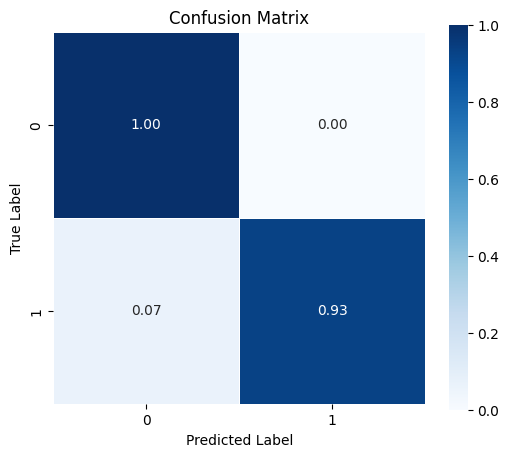

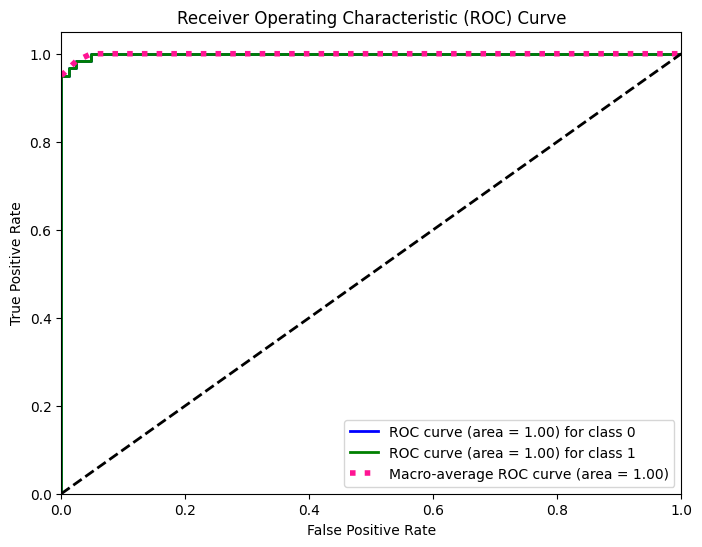

In [ ]:
from sklearn.ensemble import AdaBoostClassifier
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, classification_report
from itertools import cycle
from sklearn.preprocessing import LabelBinarizer



rf_model = AdaBoostClassifier( n_estimators=95, learning_rate=1)
rf_model.fit(x_train, y_train)


y_pred = rf_model.predict(x_test)


accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy:.4f}')
print('Classification Report:\n', classification_report(y_test, y_pred))

skf = StratifiedKFold(n_splits=10, shuffle=True)
cv_scores = cross_val_score(rf_model, x, y, cv=skf, scoring='accuracy')

print(f'Cross-Validation Accuracy: {np.mean(cv_scores):.4f}')
print()

y_pred = rf_model.predict(x_test)
y_probs = rf_model.predict_proba(x_test)[:, 1]


class_names = np.unique(y)

# Function to plot Confusion Matrix
def plot_confusion_matrix(y_true, y_pred, class_names):
    cm = confusion_matrix(y_true, y_pred)
    cm_norm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]  # Normalize

    plt.figure(figsize=(6, 5))
    sns.heatmap(cm_norm, annot=True, fmt='.2f', cmap='Blues', linewidths=0.5, square=True,
                xticklabels=class_names, yticklabels=class_names)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title('Confusion Matrix')
    plt.show()

plot_confusion_matrix(y_test, y_pred, class_names)

# Function to plot ROC Curve
lb = LabelBinarizer()
y_test_bin = lb.fit_transform(y_test)
fpr, tpr, roc_auc = {}, {}, {}


for i in range(len(class_names)):
  y_test_bin = y_test_bin.reshape(-1, 1)
  fpr[i], tpr[i], _ = roc_curve(y_test_bin, y_probs)
  roc_auc[i] = auc(fpr[i], tpr[i])

# Compute macro-average ROC curve
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(len(class_names))]))
mean_tpr = np.zeros_like(all_fpr)
for i in range(len(class_names)):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
mean_tpr /= len(class_names)
fpr['macro'], tpr['macro'] = all_fpr, mean_tpr
roc_auc['macro'] = auc(fpr['macro'], tpr['macro'])

# Plot ROC Curves
plt.figure(figsize=(8, 6))
colors = cycle(['blue', 'green', 'red', 'cyan', 'magenta', 'yellow'])
for i, color in zip(range(len(class_names)), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2, label=f'ROC curve (area = {roc_auc[i]:.2f}) for class {class_names[i]}')

plt.plot(fpr['macro'], tpr['macro'], color='deeppink', linestyle=':', linewidth=4,
         label=f'Macro-average ROC curve (area = {roc_auc["macro"]:.2f})')
plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.show()


#AdaBoostClassifier With Extracted Features

Accuracy: 0.9930
Classification Report:
               precision    recall  f1-score   support

           B       0.99      1.00      0.99        93
           M       1.00      0.98      0.99        50

    accuracy                           0.99       143
   macro avg       0.99      0.99      0.99       143
weighted avg       0.99      0.99      0.99       143

Cross-Validation Accuracy: 0.9982



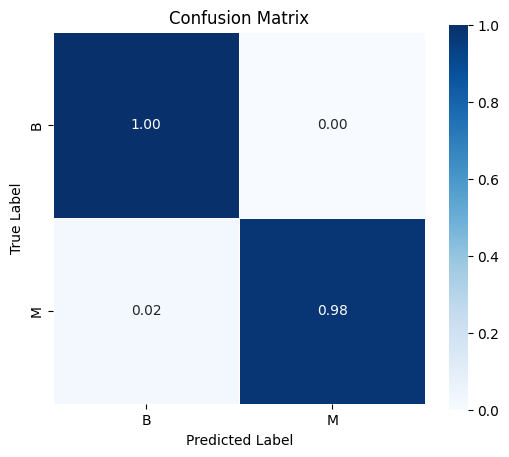

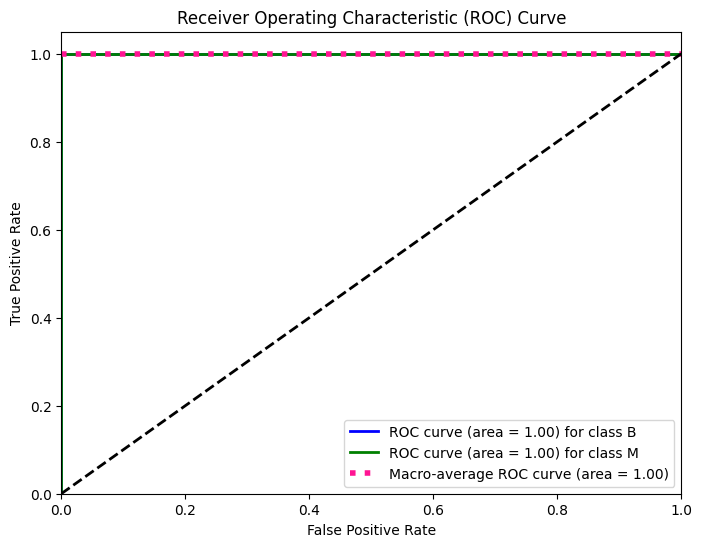

In [ ]:
from sklearn.ensemble import AdaBoostClassifier
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, classification_report
from itertools import cycle
from sklearn.preprocessing import LabelBinarizer



rf_model = AdaBoostClassifier( n_estimators=95, learning_rate=1)
rf_model.fit(x_train, y_train)


y_pred = rf_model.predict(x_test)


accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy:.4f}')
print('Classification Report:\n', classification_report(y_test, y_pred))

skf = StratifiedKFold(n_splits=10, shuffle=True)
cv_scores = cross_val_score(rf_model, x, y, cv=skf, scoring='accuracy')

print(f'Cross-Validation Accuracy: {np.mean(cv_scores):.4f}')
print()

y_pred = rf_model.predict(x_test)
y_probs = rf_model.predict_proba(x_test)[:, 1]


class_names = np.unique(y)

# Function to plot Confusion Matrix
def plot_confusion_matrix(y_true, y_pred, class_names):
    cm = confusion_matrix(y_true, y_pred)
    cm_norm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]  # Normalize

    plt.figure(figsize=(6, 5))
    sns.heatmap(cm_norm, annot=True, fmt='.2f', cmap='Blues', linewidths=0.5, square=True,
                xticklabels=class_names, yticklabels=class_names)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title('Confusion Matrix')
    plt.show()

plot_confusion_matrix(y_test, y_pred, class_names)

# Function to plot ROC Curve
lb = LabelBinarizer()
y_test_bin = lb.fit_transform(y_test)
fpr, tpr, roc_auc = {}, {}, {}


for i in range(len(class_names)):
  y_test_bin = y_test_bin.reshape(-1, 1)
  fpr[i], tpr[i], _ = roc_curve(y_test_bin, y_probs)
  roc_auc[i] = auc(fpr[i], tpr[i])

# Compute macro-average ROC curve
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(len(class_names))]))
mean_tpr = np.zeros_like(all_fpr)
for i in range(len(class_names)):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
mean_tpr /= len(class_names)
fpr['macro'], tpr['macro'] = all_fpr, mean_tpr
roc_auc['macro'] = auc(fpr['macro'], tpr['macro'])

# Plot ROC Curves
plt.figure(figsize=(8, 6))
colors = cycle(['blue', 'green', 'red', 'cyan', 'magenta', 'yellow'])
for i, color in zip(range(len(class_names)), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2, label=f'ROC curve (area = {roc_auc[i]:.2f}) for class {class_names[i]}')

plt.plot(fpr['macro'], tpr['macro'], color='deeppink', linestyle=':', linewidth=4,
         label=f'Macro-average ROC curve (area = {roc_auc["macro"]:.2f})')
plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.show()


#VotingClassifier(AdaBoost, LogisticRegression, RandomForest) Without Extracted Features

Accuracy: 0.9790
Classification Report:
               precision    recall  f1-score   support

           0       0.97      1.00      0.98        83
           1       1.00      0.95      0.97        60

    accuracy                           0.98       143
   macro avg       0.98      0.97      0.98       143
weighted avg       0.98      0.98      0.98       143

Cross-Validation Accuracy: 0.9841



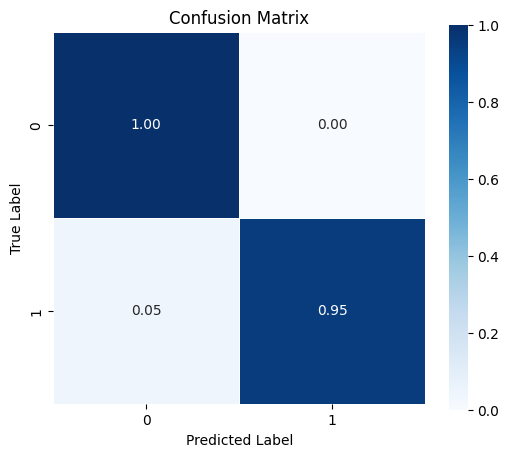

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier, VotingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.ensemble import AdaBoostClassifier, RandomForestClassifier



# Define individual classifiers
model1 = AdaBoostClassifier( n_estimators=95, learning_rate=1)
model2 = RandomForestClassifier(n_estimators=250, min_samples_split=4)
model3 = LogisticRegression(penalty='l2', solver="newton-cg")
  # Enable probability=True for soft voting

# Create Voting Classifier (Hard Voting)
voting_clf = VotingClassifier(
    estimators=[('Ad', model1), ('Rf', model2), ('Lr', model3)],
    voting='hard'  # Use 'soft' if you want probability-based averaging
)

# Train the Voting Classifier
voting_clf.fit(x_train, y_train)

# Predictions
y_pred = voting_clf.predict(x_test)

# Evaluate Performance
accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy:.4f}')
print('Classification Report:\n', classification_report(y_test, y_pred))

skf = StratifiedKFold(n_splits=10, shuffle=True)
cv_scores = cross_val_score(voting_clf, x, y, cv=skf, scoring='accuracy')

print(f'Cross-Validation Accuracy: {np.mean(cv_scores):.4f}')
print()



class_names = np.unique(y)

#  Function to plot Confusion Matrix
def plot_confusion_matrix(y_true, y_pred, class_names):
    cm = confusion_matrix(y_true, y_pred)
    cm_norm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]  # Normalize

    plt.figure(figsize=(6, 5))
    sns.heatmap(cm_norm, annot=True, fmt='.2f', cmap='Blues', linewidths=0.5, square=True,
                xticklabels=class_names, yticklabels=class_names)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title('Confusion Matrix')
    plt.show()

# Plot Confusion Matrix
class_names = np.unique(y)
plot_confusion_matrix(y_test, y_pred, class_names)



#VotingClassifier(AdaBoost, LogisticRegression, RandomForest) With Extracted Features

Accuracy: 1.0000
Classification Report:
               precision    recall  f1-score   support

           B       1.00      1.00      1.00        93
           M       1.00      1.00      1.00        50

    accuracy                           1.00       143
   macro avg       1.00      1.00      1.00       143
weighted avg       1.00      1.00      1.00       143

Cross-Validation Accuracy: 0.9982



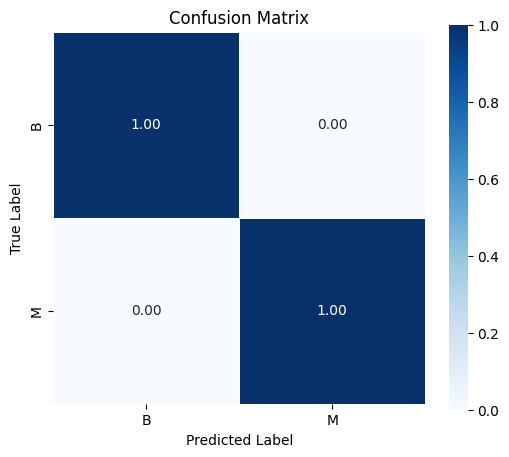

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier, VotingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.ensemble import AdaBoostClassifier, RandomForestClassifier



# Define individual classifiers
model1 = AdaBoostClassifier( n_estimators=95, learning_rate=1)
model2 = RandomForestClassifier(n_estimators=250, min_samples_split=4)
model3 = LogisticRegression(penalty='l2', solver="newton-cg")
  # Enable probability=True for soft voting

# Create Voting Classifier (Hard Voting)
voting_clf = VotingClassifier(
    estimators=[('Ad', model1), ('Rf', model2), ('Lr', model3)],
    voting='hard'  # Use 'soft' if you want probability-based averaging
)

# Train the Voting Classifier
voting_clf.fit(x_train, y_train)

# Predictions
y_pred = voting_clf.predict(x_test)

# Evaluate Performance
accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy:.4f}')
print('Classification Report:\n', classification_report(y_test, y_pred))

skf = StratifiedKFold(n_splits=10, shuffle=True)
cv_scores = cross_val_score(voting_clf, x, y, cv=skf, scoring='accuracy')

print(f'Cross-Validation Accuracy: {np.mean(cv_scores):.4f}')
print()



class_names = np.unique(y)

#  Function to plot Confusion Matrix
def plot_confusion_matrix(y_true, y_pred, class_names):
    cm = confusion_matrix(y_true, y_pred)
    cm_norm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]  # Normalize

    plt.figure(figsize=(6, 5))
    sns.heatmap(cm_norm, annot=True, fmt='.2f', cmap='Blues', linewidths=0.5, square=True,
                xticklabels=class_names, yticklabels=class_names)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title('Confusion Matrix')
    plt.show()

# Plot Confusion Matrix
class_names = np.unique(y)
plot_confusion_matrix(y_test, y_pred, class_names)



#DNN Without Extracted Features

In [ ]:
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow import keras
from sklearn.model_selection import StratifiedKFold
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import LabelBinarizer
lb = LabelBinarizer()


# Define target column name
target_column = "diagnosis"  # Replace with actual target column name

# Separate features (X) and target (y)
X = df.drop(columns=[target_column]).values  # Features
y = df[target_column].values  # Target
y = lb.fit_transform(y)
# Normalize features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Convert target to binary if necessary
if len(np.unique(y)) > 2:  # If more than 2 classes, use one-hot encoding
    y = pd.get_dummies(y).values

# Stratified K-Fold Cross-Validation
skf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)
fold_accuracies = []

# Early Stopping Callback
early_stopping = keras.callbacks.EarlyStopping(
    monitor="val_loss",  # Monitor validation loss
    patience=5,  # Stop training if no improvement after 5 epochs
    restore_best_weights=True  # Restore the best model after stopping
)
# Function to create the model
def create_model():
    model = keras.Sequential([
        keras.layers.Dense(256, activation='relu', input_shape=(X.shape[1],)),
        keras.layers.Dense(128, activation='relu'),
        keras.layers.Dropout(0.25),
        keras.layers.Dense(64, activation='relu'),
        keras.layers.Dropout(0.25),
        keras.layers.Dense(16, activation='relu'),
        keras.layers.Dropout(0.25),
        keras.layers.Dense(1, activation='sigmoid')  # Binary classification
    ])
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model

# Perform cross-validation
for train_idx, val_idx in skf.split(X_scaled, y):
    X_train, X_val = X_scaled[train_idx], X_scaled[val_idx]
    y_train, y_val = y[train_idx], y[val_idx]

    model = create_model()
    model.fit(X_train, y_train, epochs=20, batch_size=32, verbose=0,validation_data=(X_val, y_val), callbacks=[early_stopping])

    # Evaluate on validation set
    loss, acc = model.evaluate(X_val, y_val, verbose=1)
    fold_accuracies.append(acc)

# Print average accuracy across folds
print(f"Mean Cross-Validation Accuracy: {np.mean(fold_accuracies):.4f}")


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - accuracy: 1.0000 - loss: 0.0299
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - accuracy: 1.0000 - loss: 0.0012    
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - accuracy: 1.0000 - loss: 0.0168
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - accuracy: 0.9337 - loss: 0.2176
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step - accuracy: 0.9558 - loss: 0.1759
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - accuracy: 0.9779 - loss: 0.0811
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - accuracy: 1.0000 - loss: 2.3949e-04
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - accuracy: 0.9662 - loss: 0.0767
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - accuracy: 0.9779 - loss: 0.0735
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - accuracy: 1.0000 - loss: 0.0017
Mean Cross-Validation Accuracy: 0.9842


#DNN With Extracted Features

In [ ]:
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow import keras
from sklearn.model_selection import StratifiedKFold
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import LabelBinarizer
lb = LabelBinarizer()


# Define target column name
target_column = "diagnosis"  # Replace with actual target column name

# Separate features (X) and target (y)
X_scaled = x  # Features
y = df[target_column].values  # Target
y = lb.fit_transform(y)



# Stratified K-Fold Cross-Validation
skf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)
fold_accuracies = []

# Early Stopping Callback
early_stopping = keras.callbacks.EarlyStopping(
    monitor="val_loss",  # Monitor validation loss
    patience=5,  # Stop training if no improvement after 5 epochs
    restore_best_weights=True  # Restore the best model after stopping
)
# Function to create the model
def create_model():
    model = keras.Sequential([
        keras.layers.Dense(256, activation='relu', input_shape=(X_scaled.shape[1],)),
        keras.layers.Dense(128, activation='relu'),
        keras.layers.Dropout(0.25),
        keras.layers.Dense(64, activation='relu'),
        keras.layers.Dropout(0.25),
        keras.layers.Dense(16, activation='relu'),
        keras.layers.Dropout(0.25),
        keras.layers.Dense(1, activation='sigmoid')  # Binary classification
    ])
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model

# Perform cross-validation
for train_idx, val_idx in skf.split(X_scaled, y):
    X_train, X_val = X_scaled[train_idx], X_scaled[val_idx]
    y_train, y_val = y[train_idx], y[val_idx]

    model = create_model()
    model.fit(X_train, y_train, epochs=20, batch_size=32, verbose=0,validation_data=(X_val, y_val), callbacks=[early_stopping])

    # Evaluate on validation set
    loss, acc = model.evaluate(X_val, y_val, verbose=1)
    fold_accuracies.append(acc)

# Print average accuracy across folds
print(f"Mean Cross-Validation Accuracy: {np.mean(fold_accuracies):.4f}")


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - accuracy: 1.0000 - loss: 1.2386e-05
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - accuracy: 1.0000 - loss: 3.6387e-07
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - accuracy: 1.0000 - loss: 6.1615e-05
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - accuracy: 1.0000 - loss: 0.0098
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - accuracy: 1.0000 - loss: 5.5213e-05
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - accuracy: 1.0000 - loss: 1.9813e-04
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - accuracy: 1.0000 - loss: 2.4360e-09
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step - accuracy: 1.0000 - loss: 5.3214e-04
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - accuracy: 1.0000 - loss: 8.0375e-06
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - accuracy: 1.0000 - loss: 1.1338e-04
Mean Cross-Validation Accuracy: 1.0000


In [ ]:
fold_accuracies

[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

In [ ]:
y_pred = model.predict(x_test)
y_pred = (y_pred > 0.5).astype(int)

y_test=lb.fit_transform(y_test)
accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy:.4f}')
print('Classification Report:\n', classification_report(y_test, y_pred))




5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step 
Accuracy: 1.0000
Classification Report:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00        96
           1       1.00      1.00      1.00        47

    accuracy                           1.00       143
   macro avg       1.00      1.00      1.00       143
weighted avg       1.00      1.00      1.00       143



5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 


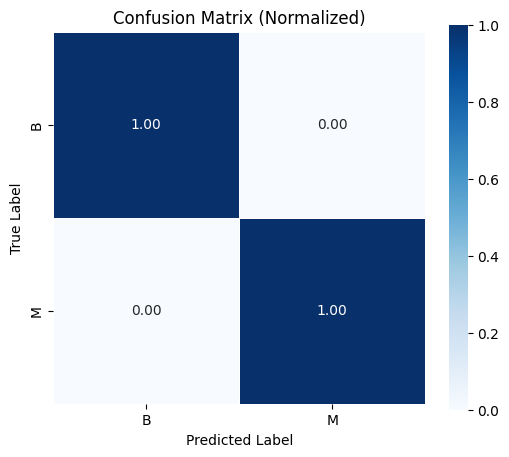

In [ ]:
y_probs = model.predict(x_test)  # Use predict(), not predict_proba()
y_pred = (y_probs > 0.5).astype(int)  # Convert probabilities to binary predictions

# Get unique class names
class_names = np.unique(df['diagnosis'])

# Function to plot Confusion Matrix (Percentage)
def plot_confusion_matrix(y_true, y_pred, class_names):
    y_true=lb.fit_transform(y_true)
    cm = confusion_matrix(y_true, y_pred)
    cm_norm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]  # Normalize

    plt.figure(figsize=(6, 5))
    sns.heatmap(cm_norm, annot=True, fmt='.2f', cmap='Blues', linewidths=0.5, square=True,
                xticklabels=class_names, yticklabels=class_names)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title('Confusion Matrix (Normalized)')
    plt.show()

plot_confusion_matrix(y_test, y_pred, class_names)

# Function to plot ROC Curve
lb3 = LabelBinarizer()
y_test_bin = lb3.fit_transform(y_test)

# Ensure correct shape for binary classification
if y_test_bin.shape[1] == 1:
    y_test_bin = np.hstack((1 - y_test_bin, y_test_bin))

fpr, tpr, roc_auc = {}, {}, {}

# Compute ROC curve for each class
for i in range(len(class_names)):
    fpr[i], tpr[i], _ = roc_curve(y_test_bin[:, i], y_probs)
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute macro-average ROC curve
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(len(class_names))]))
mean_tpr = np.zeros_like(all_fpr)
for i in range(len(class_names)):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
mean_tpr /= len(class_names)
fpr['macro'], tpr['macro'] = all_fpr, mean_tpr
roc_auc['macro'] = auc(fpr['macro'], tpr['macro'])

# Plot ROC Curves
plt.figure(figsize=(8, 6))
colors = cycle(['blue', 'green', 'red', 'cyan', 'magenta', 'yellow'])
for i, color in zip(range(len(class_names)), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2, label=f'ROC curve (AUC = {roc_auc[i]:.2f}) for class {class_names[i]}')

plt.plot(fpr['macro'], tpr['macro'], color='deeppink', linestyle=':', linewidth=4,
         label=f'Macro-average ROC curve (AUC = {roc_auc["macro"]:.2f})')
plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.show()

# Print Classification Report & Accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy:.4f}')
print('Classification Report:\n', classification_report(y_test, y_pred))


5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step


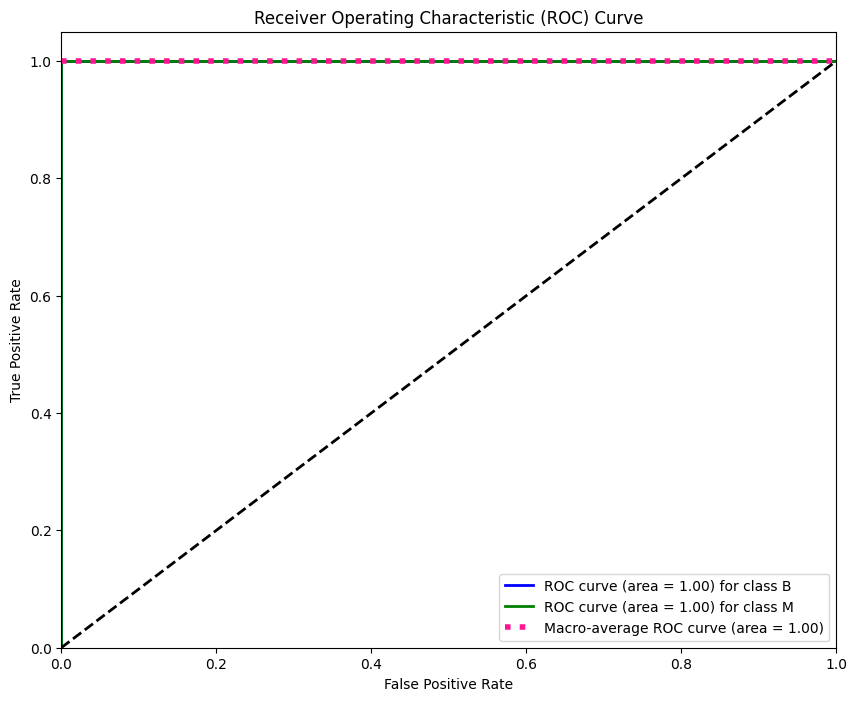

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from itertools import cycle
from sklearn.metrics import roc_auc_score
from tensorflow.keras.models import load_model

# Assuming you have test data, labels, and predictions
# test_data = ...
# test_labels = ...
# test_predictions = ...

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.25, shuffle=True)
# Number of classes
num_classes = 2

test_lables=df['diagnosis']

# Map class names to their corresponding numbers
class_mapping = {'B': 0, 'M': 1}
# Reverse the mapping to get class names from numbers
class_names = {v: k for k, v in class_mapping.items()}


# Predict probabilities
y_score = model.predict(x_test)

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()

for i in range(num_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test, y_score)
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute macro-average ROC curve and ROC area
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(num_classes)]))

# Interpolate ROC curves at these points
mean_tpr = np.zeros_like(all_fpr)
for i in range(num_classes):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])

# Average and compute AUC
mean_tpr /= num_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot ROC curves
plt.figure(figsize=(10, 8))

# Plot individual ROC curves
colors = cycle(['blue', 'green', 'red', 'cyan', 'magenta', 'yellow', 'black', 'purple', 'orange'])
for i, color in zip(range(num_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2, label='ROC curve (area = {:.2f}) for class {}'.format(roc_auc[i], class_names[i]))

# Plot macro-average ROC curve
plt.plot(fpr["macro"], tpr["macro"], color='deeppink', linestyle=':', linewidth=4, label='Macro-average ROC curve (area = {:.2f})'.format(roc_auc["macro"]))

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()